In [1]:
%load_ext autoreload
%autoreload 2

from pathlib import Path
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd

import scanpy as sc

from sciso.plot import *
from sciso.spatial_plot import *
import re
from sciso.parse_spacem_dir import add_spacem_images

In [2]:
set_nature_style()

In [3]:
# Input
data_dir = Path(r"/media/buglakova/embl_data/data/lipid_isotope/20220411_AB_DKFZACLYac") 
anndata_dir = data_dir / "anndata"
adata_path = anndata_dir / "aclykd_adata_concat_fit.h5ad"
adata_am_path =anndata_dir / "aclykd_adata_am_concat.h5ad"

# Output
plots_path = data_dir / "uptake_heterogenety_plots"
plots_path.mkdir(parents=True, exist_ok=True)
sc.settings.figdir = plots_path

In [4]:
spacem_dir_list = [spacem_dir.parent for spacem_dir in data_dir.glob("**/*config.json")]

In [5]:
adata_am = sc.read_h5ad(adata_am_path)
adata = sc.read_h5ad(adata_path)

In [6]:
adata_am

AnnData object with n_obs × n_vars = 240000 × 100
    obs: 'center_x', 'center_y', 'am_area', 'am_sampling_area', 'am_sampling_ratio', 'am_nearest_cell_distance', 'centroid-0', 'centroid-1', 'bbox-0', 'bbox-1', 'bbox-2', 'bbox-3', 'local_centroid-0', 'local_centroid-1', 'area', 'filled_area', 'solidity', 'perimeter', 'eccentricity', 'euler_number', 'moments_hu-0', 'moments_hu-1', 'moments_hu-2', 'moments_hu-3', 'moments_hu-4', 'moments_hu-5', 'moments_hu-6', 'moments_central-0-0', 'moments_central-0-1', 'moments_central-0-2', 'moments_central-0-3', 'moments_central-1-0', 'moments_central-1-1', 'moments_central-1-2', 'moments_central-1-3', 'moments_central-2-0', 'moments_central-2-1', 'moments_central-2-2', 'moments_central-2-3', 'moments_central-3-0', 'moments_central-3-1', 'moments_central-3-2', 'moments_central-3-3', 'inertia_tensor_eigvals-0', 'inertia_tensor_eigvals-1', 'major_axis_length', 'minor_axis_length', 'weighted_moments_central-0-0-Dapi', 'weighted_moments_central-0-0-GFP'

In [7]:
adata

AnnData object with n_obs × n_vars = 6257 × 87
    obs: 'center_x', 'center_y', 'cell_area', 'cell_sampling_area', 'cell_sampling_ratio', 'cell_nearest_am_distance', 'cell_nearest_cell_distance', 'centroid-0', 'centroid-1', 'bbox-0', 'bbox-1', 'bbox-2', 'bbox-3', 'local_centroid-0', 'local_centroid-1', 'area', 'filled_area', 'solidity', 'perimeter', 'eccentricity', 'euler_number', 'moments_hu-0', 'moments_hu-1', 'moments_hu-2', 'moments_hu-3', 'moments_hu-4', 'moments_hu-5', 'moments_hu-6', 'moments_central-0-0', 'moments_central-0-1', 'moments_central-0-2', 'moments_central-0-3', 'moments_central-1-0', 'moments_central-1-1', 'moments_central-1-2', 'moments_central-1-3', 'moments_central-2-0', 'moments_central-2-1', 'moments_central-2-2', 'moments_central-2-3', 'moments_central-3-0', 'moments_central-3-1', 'moments_central-3-2', 'moments_central-3-3', 'inertia_tensor_eigvals-0', 'inertia_tensor_eigvals-1', 'major_axis_length', 'minor_axis_length', 'weighted_moments_central-0-0-Dapi', '

C18H36O2-H


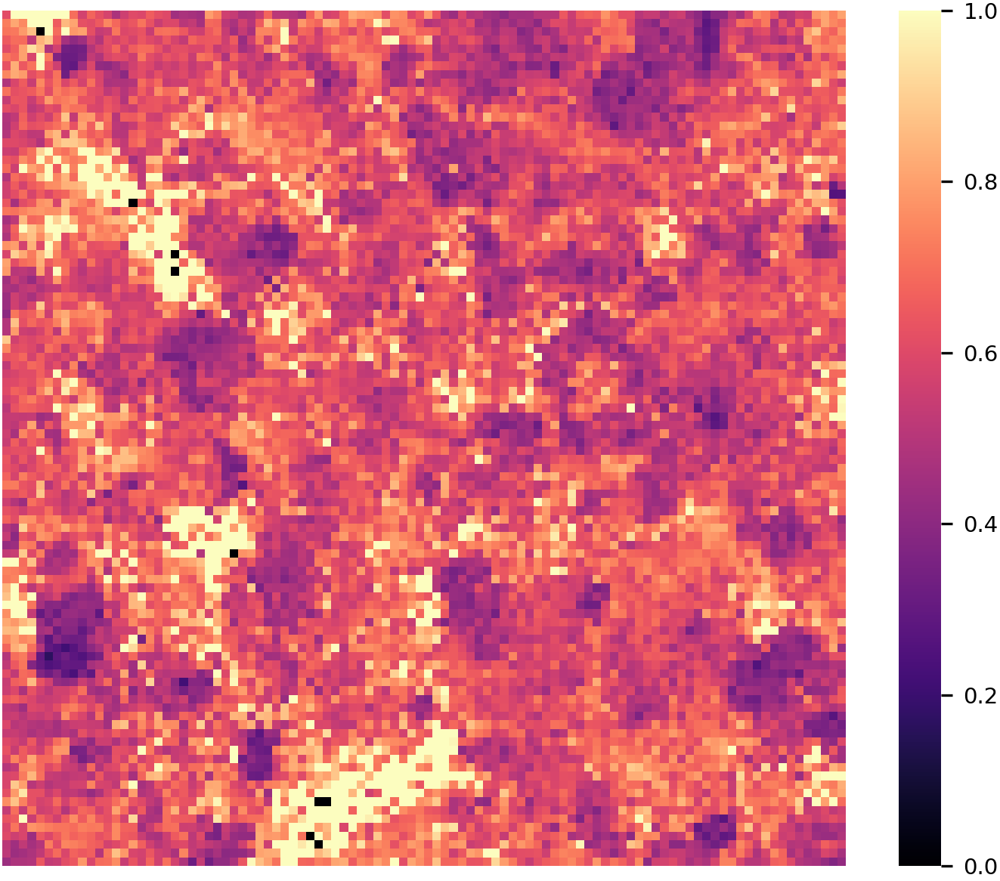

C18H34O2-H


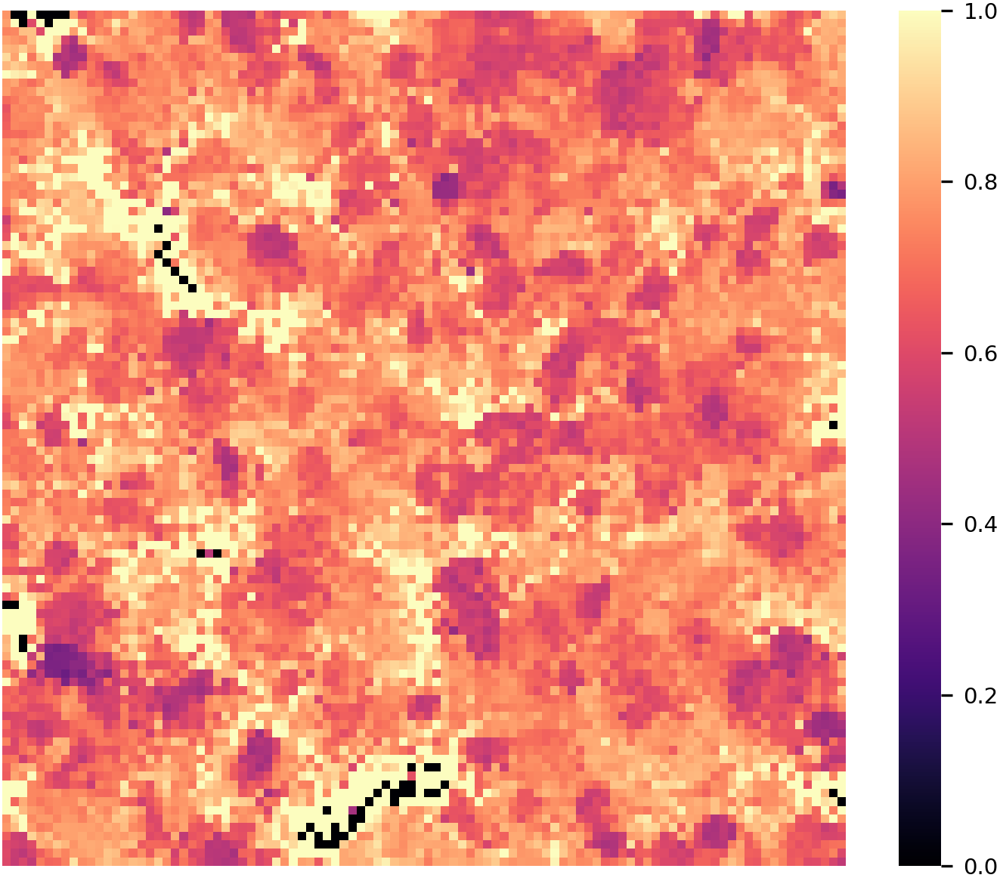

C16H32O2-H


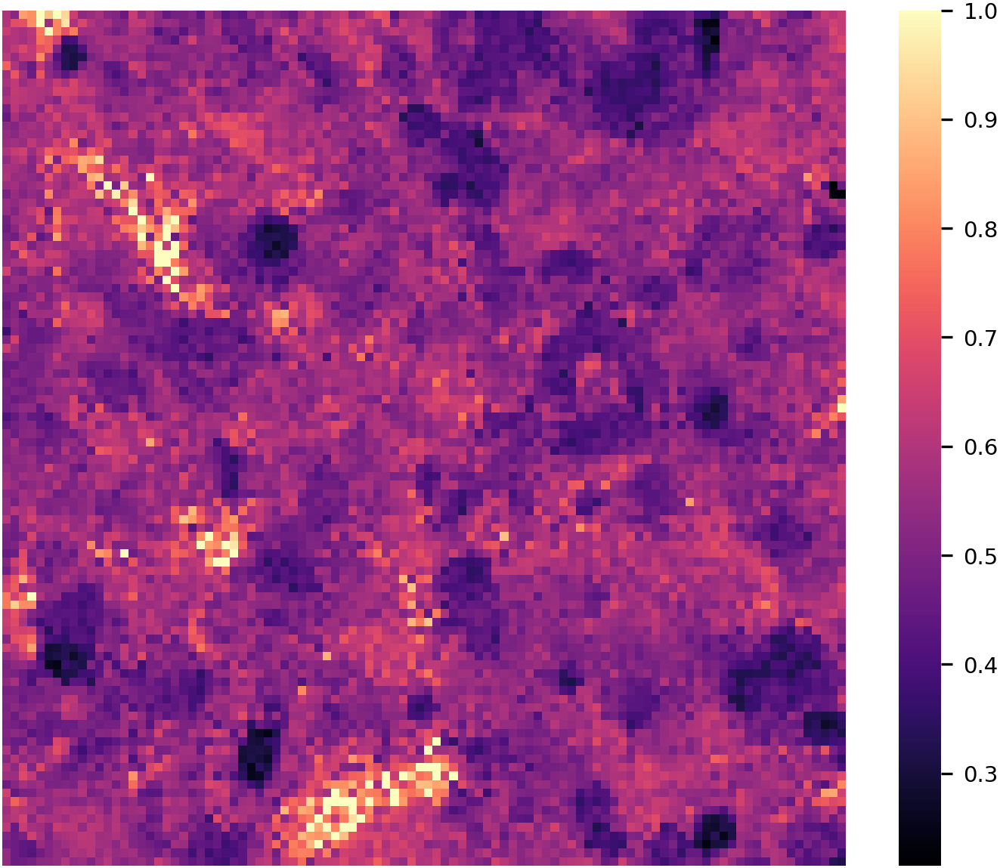

C16H30O2-H


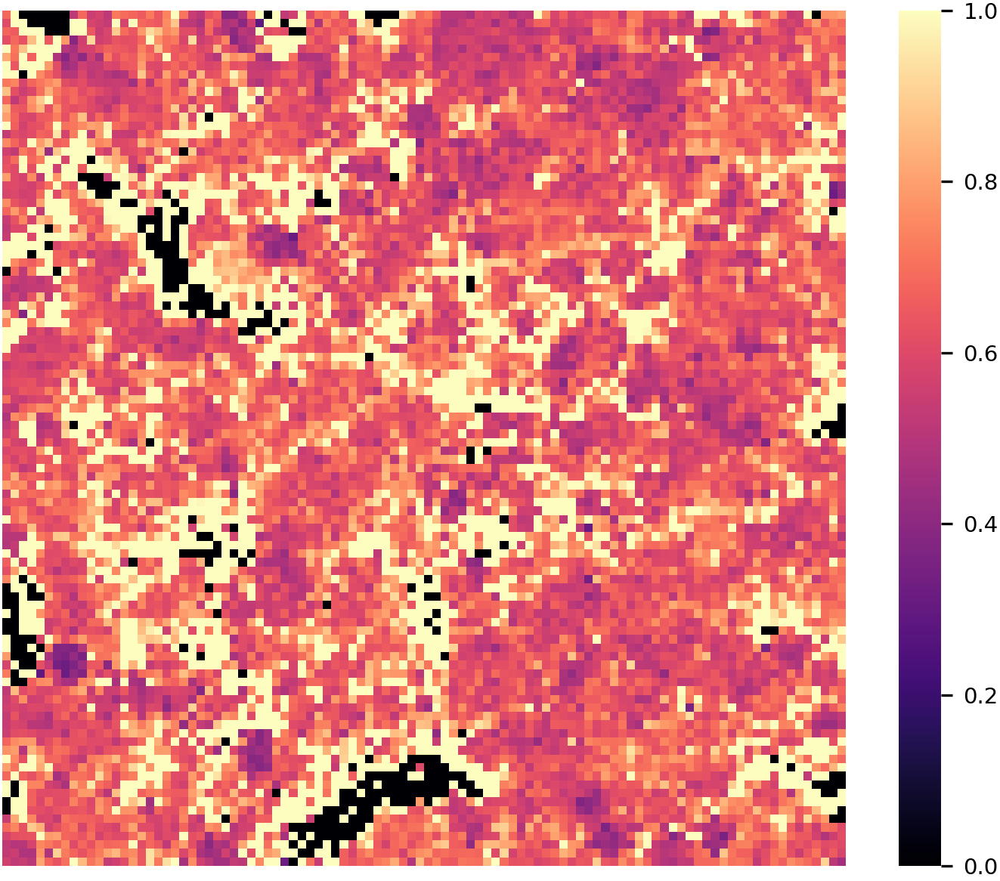

C14H28O2-H


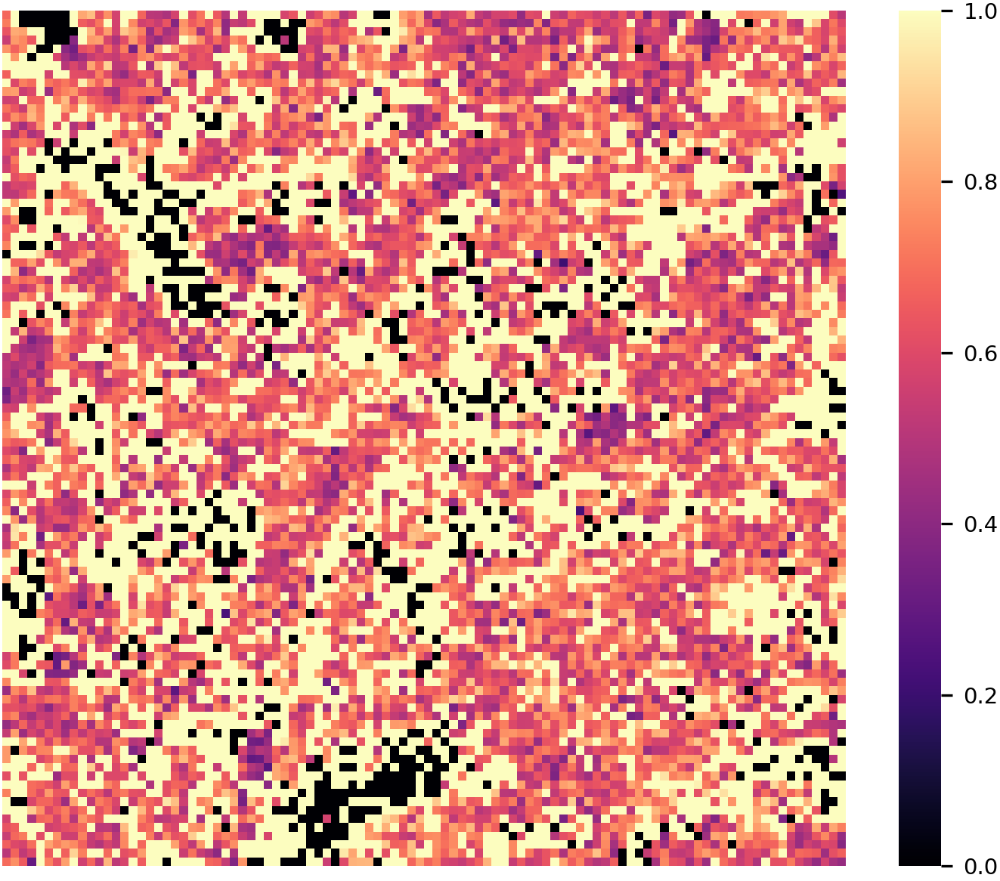

C12H24O2-H


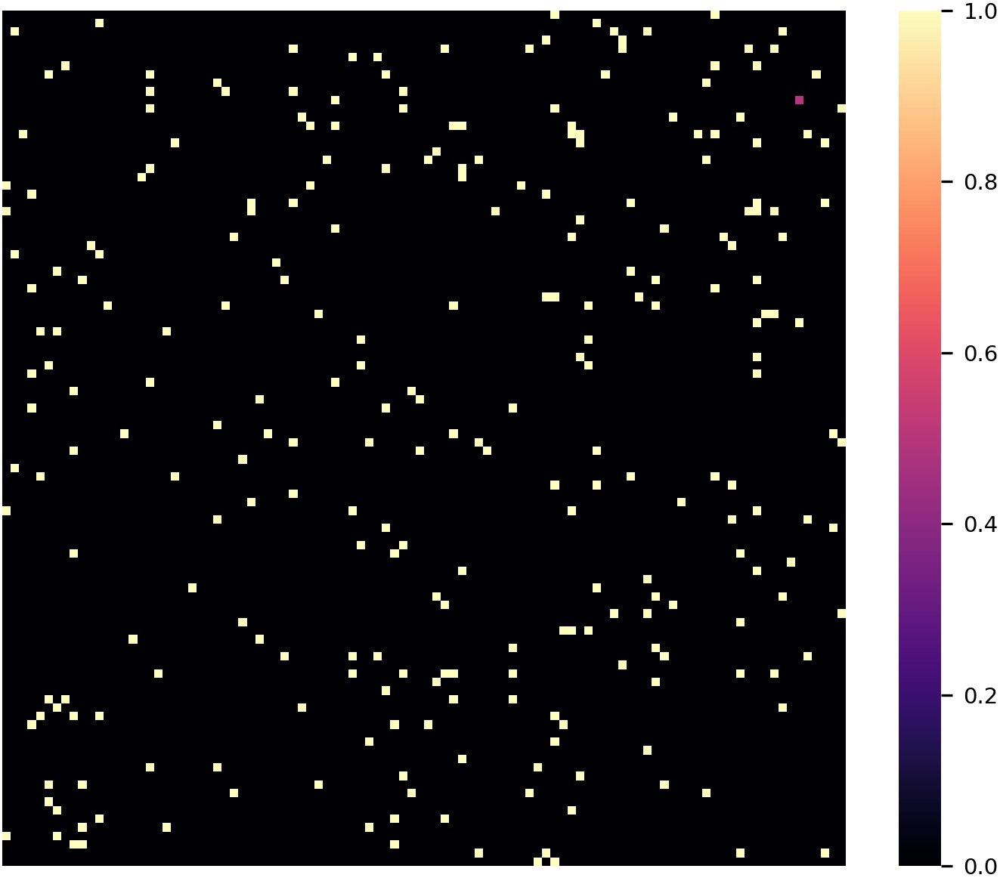

In [125]:
adata_am_S3W7 = adata_am[(adata_am.obs.slide == 3) & (adata_am.obs.well == 7)]
image_shape = (100, 100)
(plots_path / "S3W7_norm_ion_images").mkdir(exist_ok=True)
for idx, ion in adata_am_S3W7.var[adata_am_S3W7.var["M+"] == 0].iterrows():
    print(idx) 
    ion_X = adata_am_S3W7[:, idx].layers['corr_norm']
    plt.figure(figsize=(6, 5))
    sns.heatmap(ion_X.reshape(image_shape), cmap="magma", cbar=True, linewidths=0)
    plt.axis("off")
    plt.savefig(plots_path / "S3W7_norm_ion_images" / f"{ion.name}.svg")
    plt.savefig(plots_path / "S3W7_norm_ion_images" / f"{ion.name}.png")
    plt.show()

C18H36O2-H


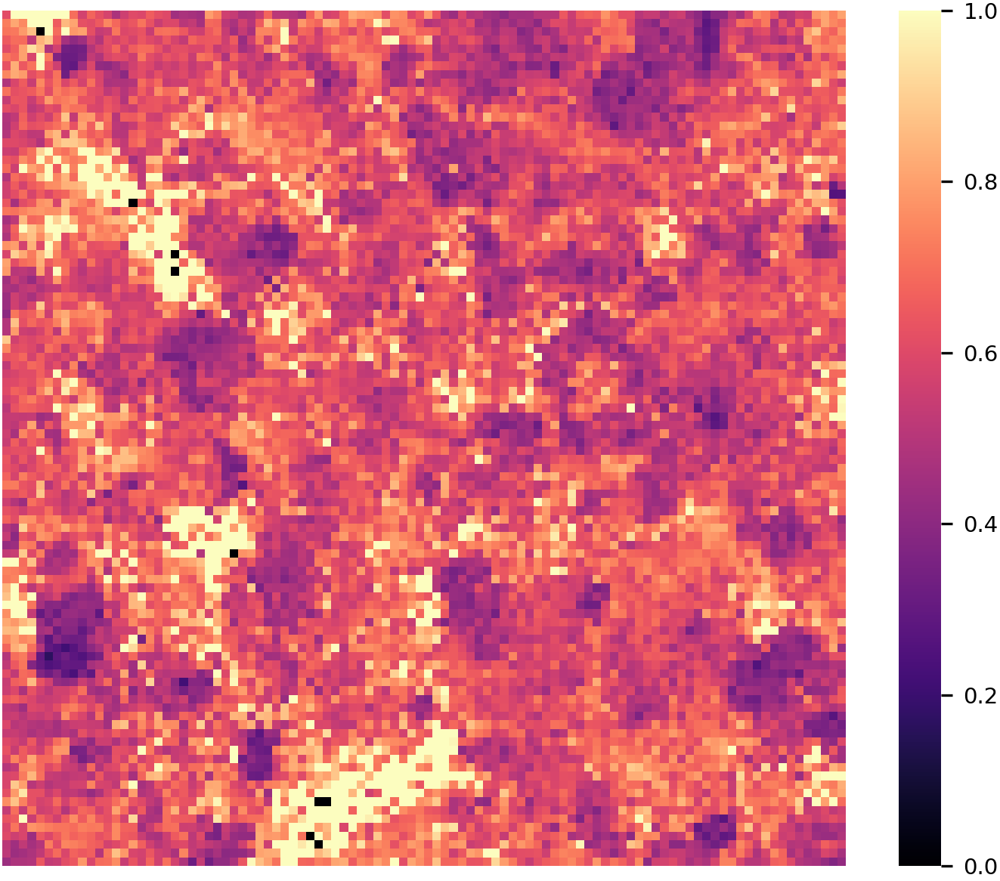

C18H34O2-H


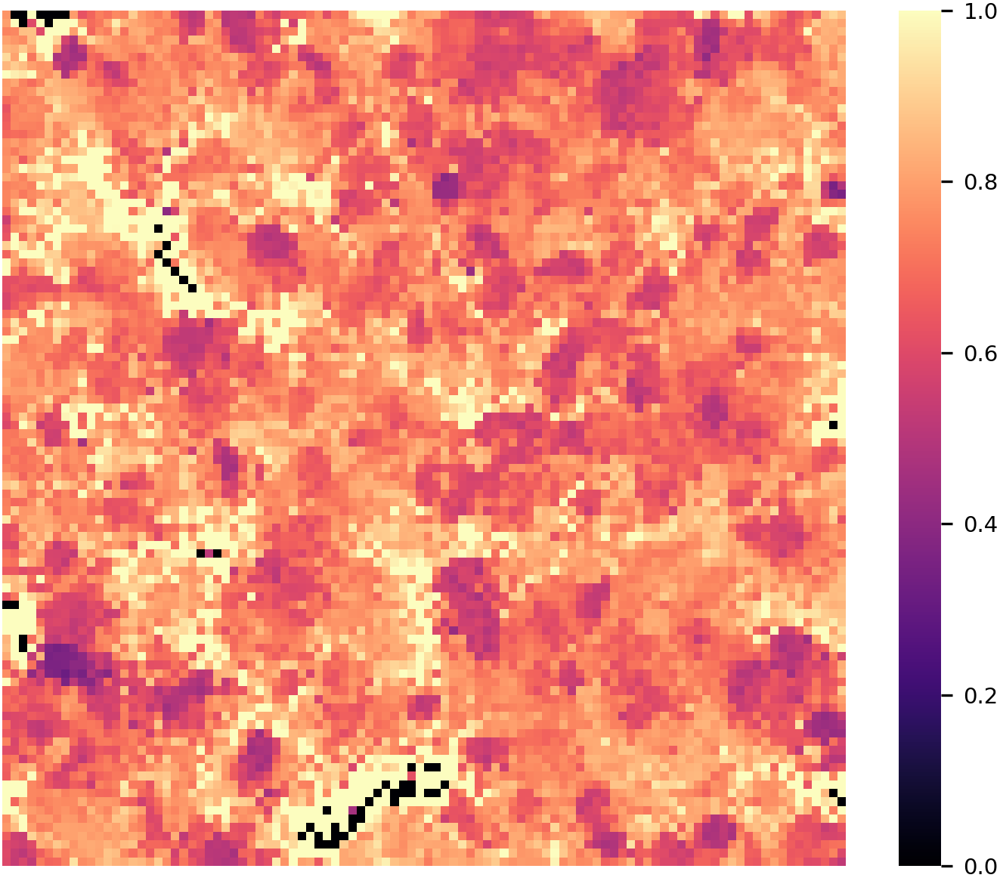

C16H32O2-H


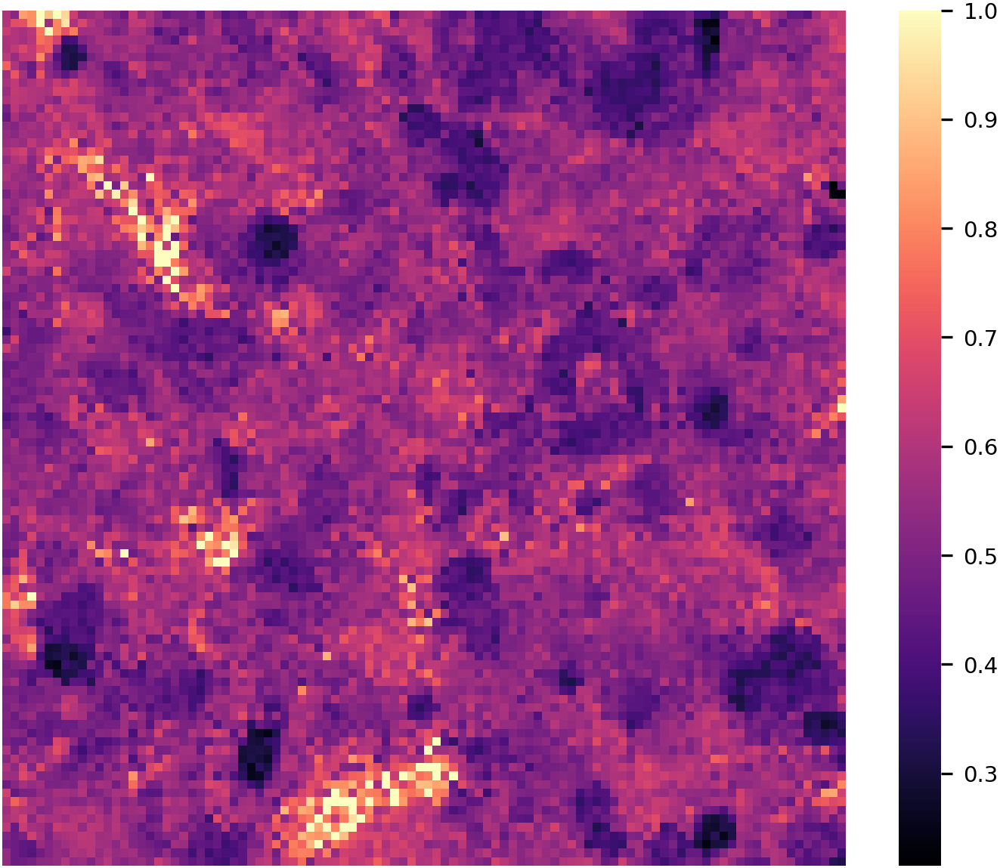

C16H30O2-H


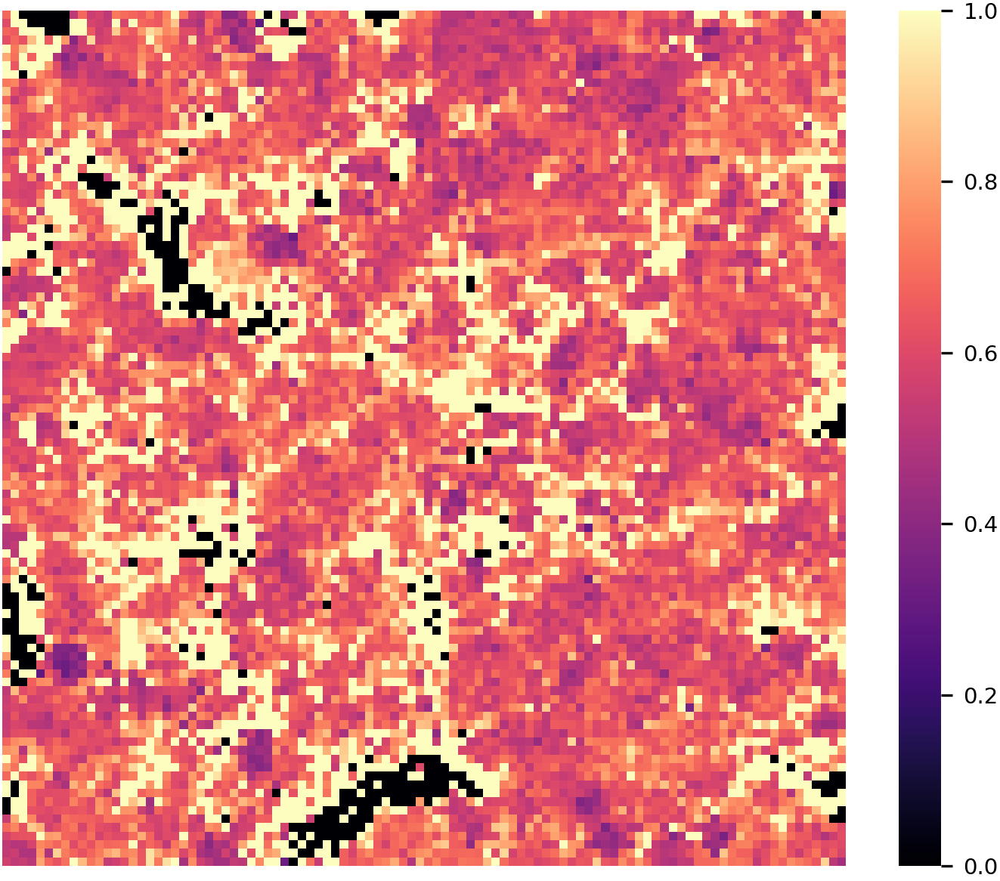

C14H28O2-H


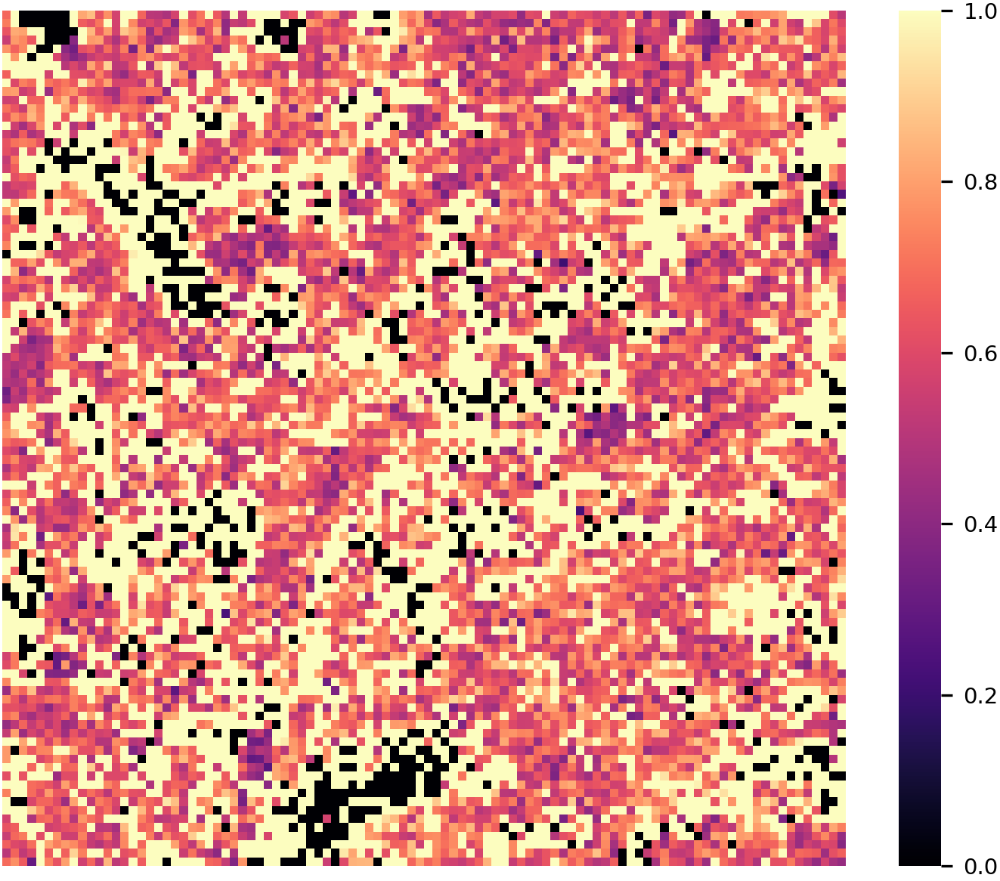

C12H24O2-H


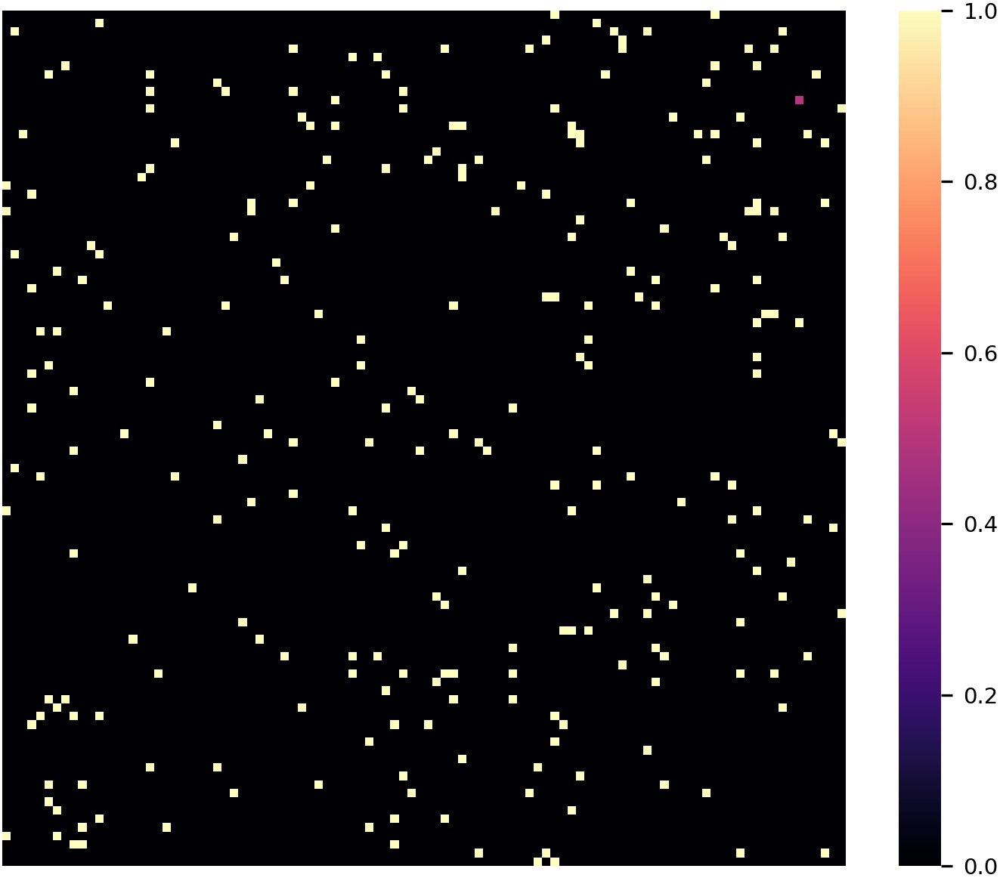

In [62]:
adata_am_S1W1 = adata_am[(adata_am.obs.slide == 3) & (adata_am.obs.well == 7)]
image_shape = (100, 100)
(plots_path / "S1W1_norm_ion_images").mkdir(exist_ok=True)
for idx, ion in adata_am_S1W1.var[adata_am_S1W1.var["M+"] == 0].iterrows():
    print(idx) 
    ion_X = adata_am_S1W1[:, idx].layers['corr_norm']
    plt.figure(figsize=(6, 5))
    sns.heatmap(ion_X.reshape(image_shape), cmap="magma", cbar=True, linewidths=0)
    plt.axis("off")
    plt.savefig(plots_path / "S1W1_norm_ion_images" / f"{ion.name}.svg")
    plt.savefig(plots_path / "S1W1_norm_ion_images" / f"{ion.name}.png")
    plt.show()

C18H36O2-H


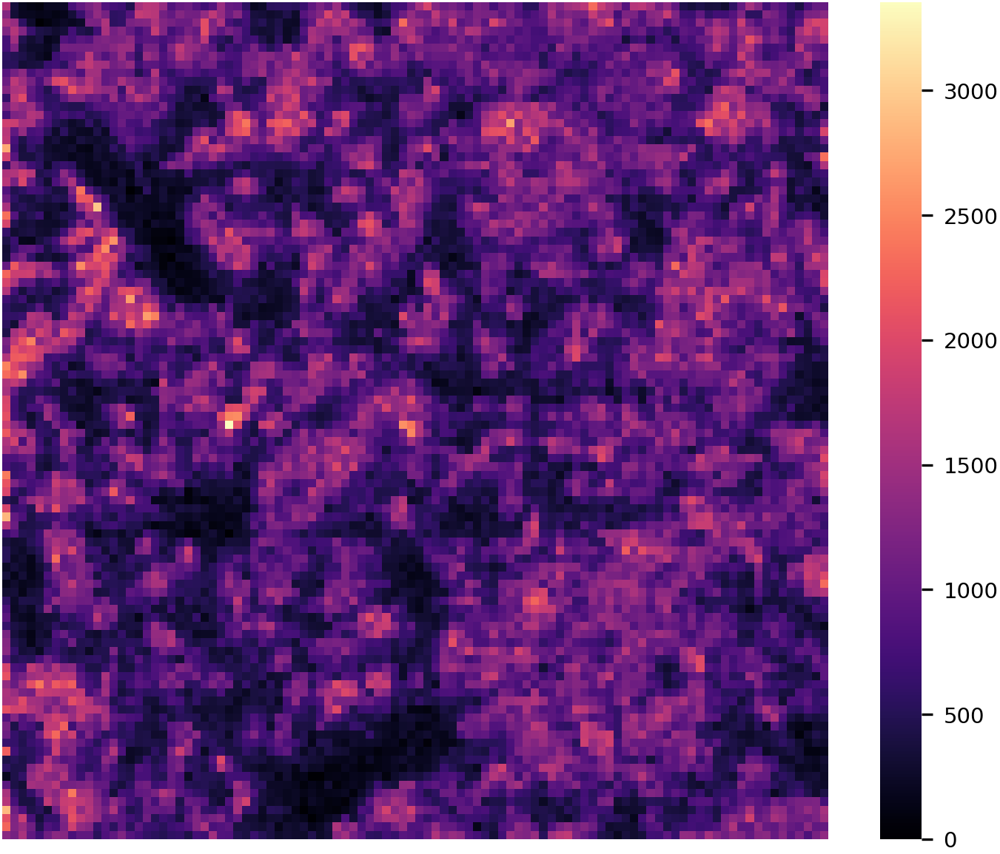

C18H34O2-H


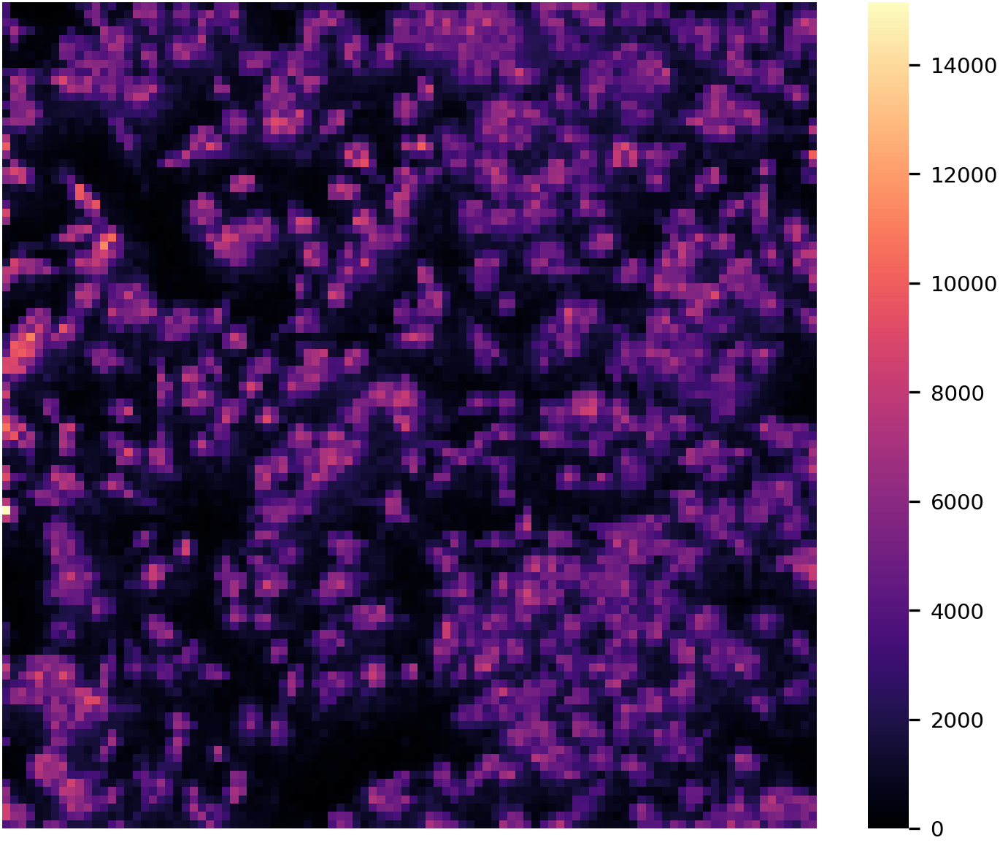

C16H32O2-H


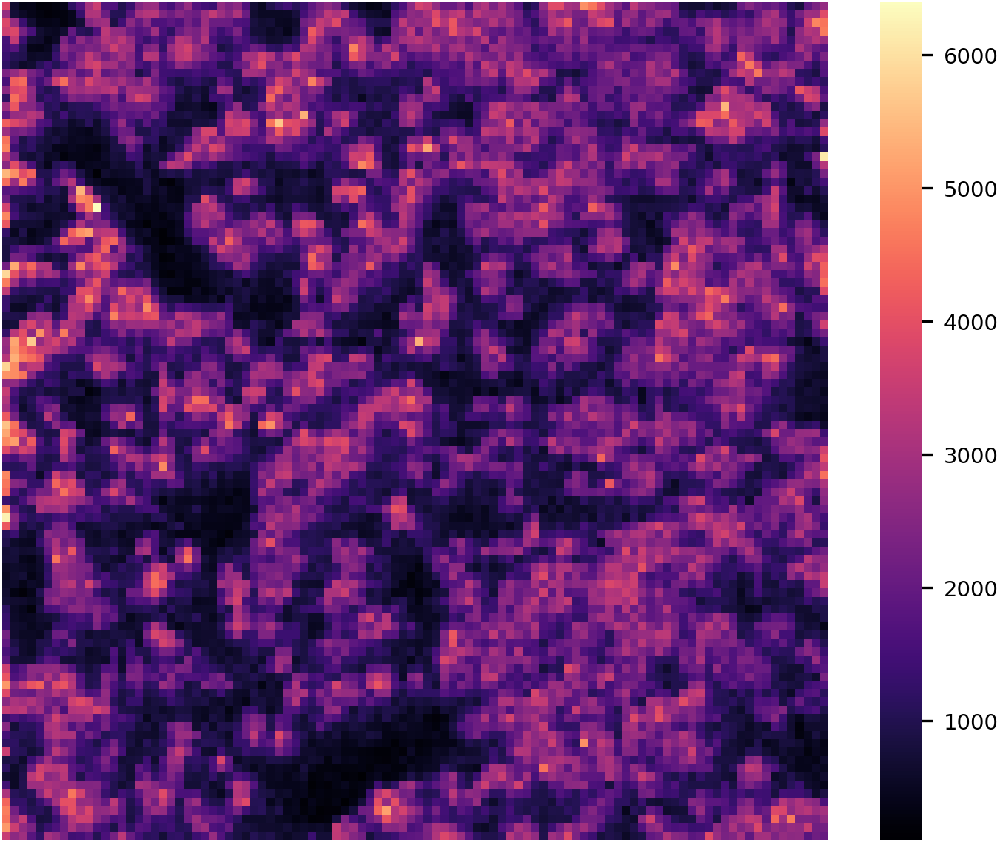

C16H30O2-H


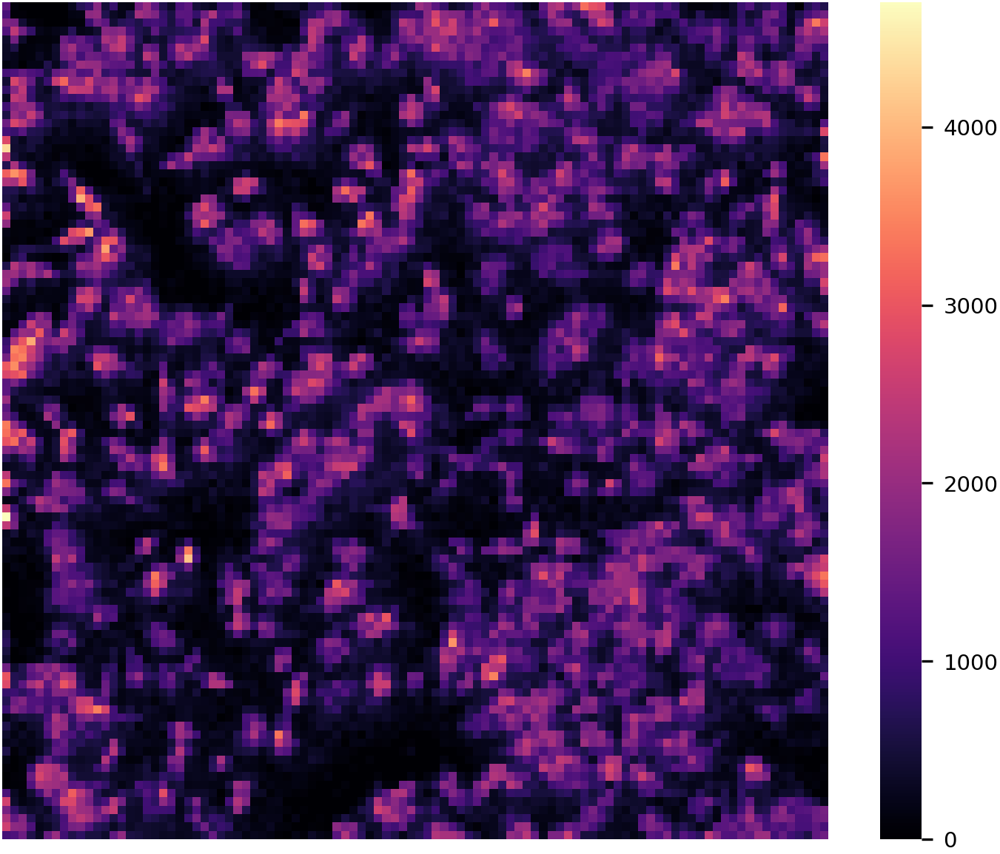

C14H28O2-H


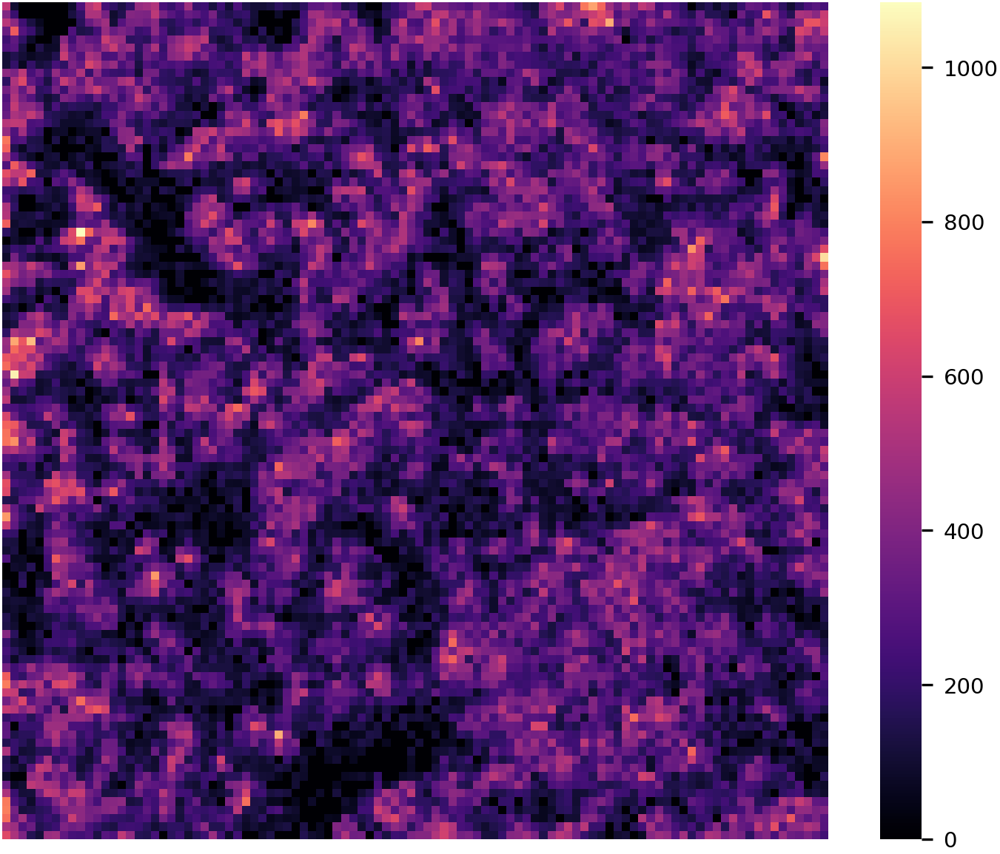

C12H24O2-H


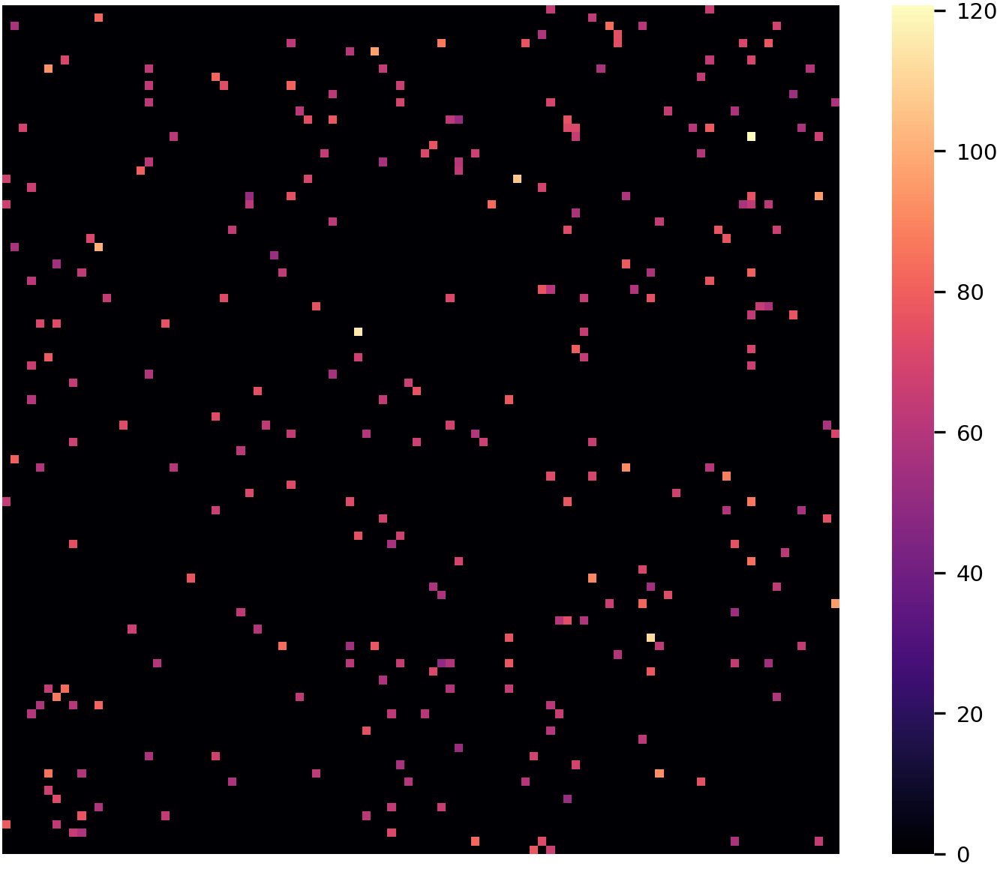

In [121]:
adata_am_S3W7 = adata_am[(adata_am.obs.slide == 3) & (adata_am.obs.well == 7)]
image_shape = (100, 100)
(plots_path / "S3W7_raw_ion_images").mkdir()
for idx, ion in adata_am_S3W7.var[adata_am_S3W7.var["M+"] == 0].iterrows():
    print(idx) 
    ion_X = adata_am_S3W7[:, idx].X
    plt.figure(figsize=(6, 5))
    sns.heatmap(ion_X.reshape(image_shape), cmap="magma", cbar=True)
    plt.axis("off")
    plt.savefig(plots_path / "S3W7_raw_ion_images" / f"{ion.name}.svg")
    plt.savefig(plots_path / "S3W7_raw_ion_images" / f"{ion.name}.png")
    plt.show()

C18H36O2-H


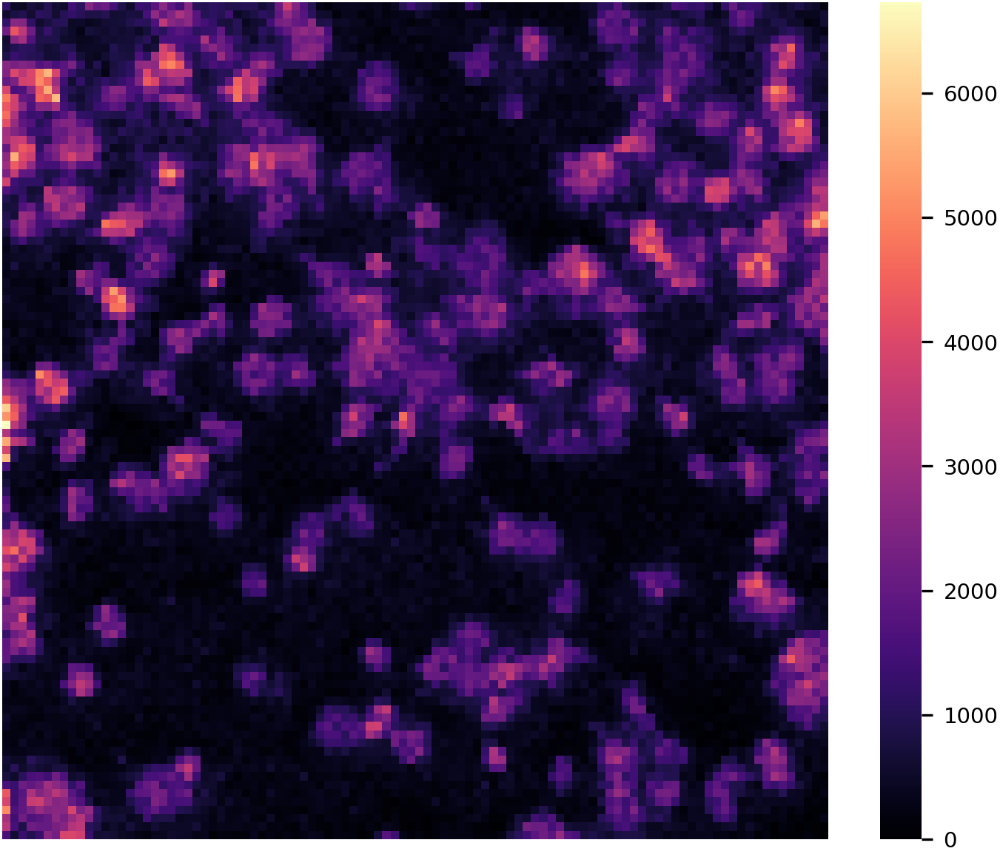

C18H34O2-H


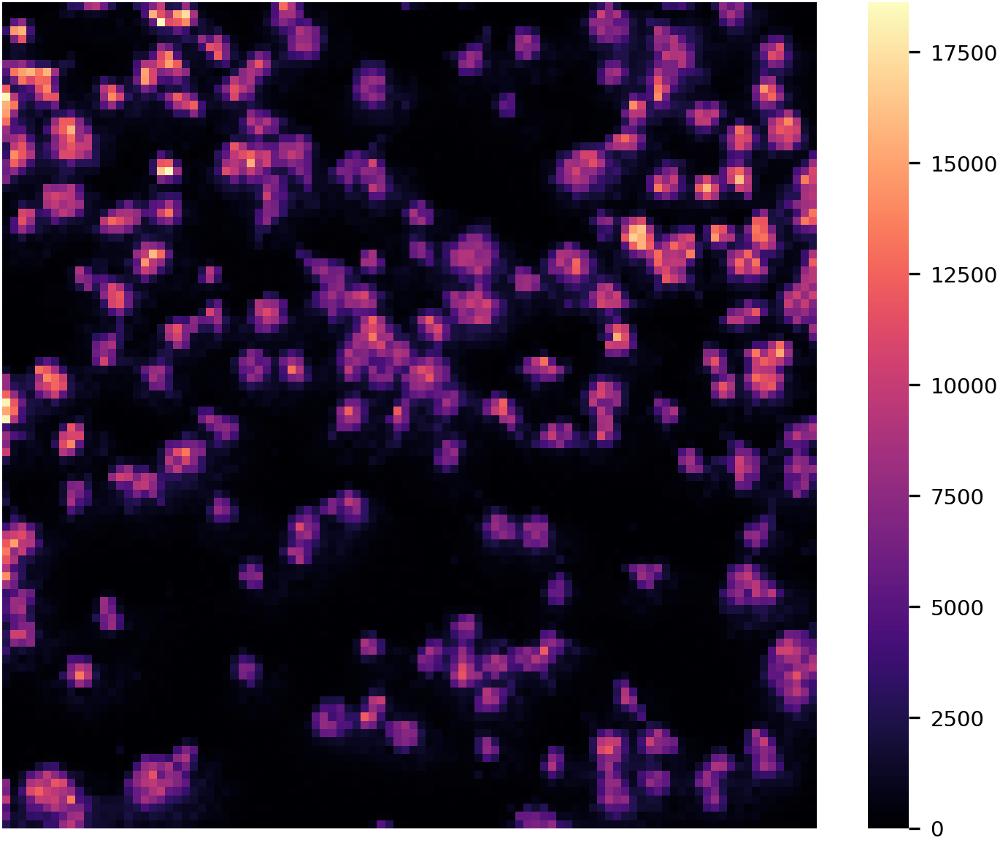

C16H32O2-H


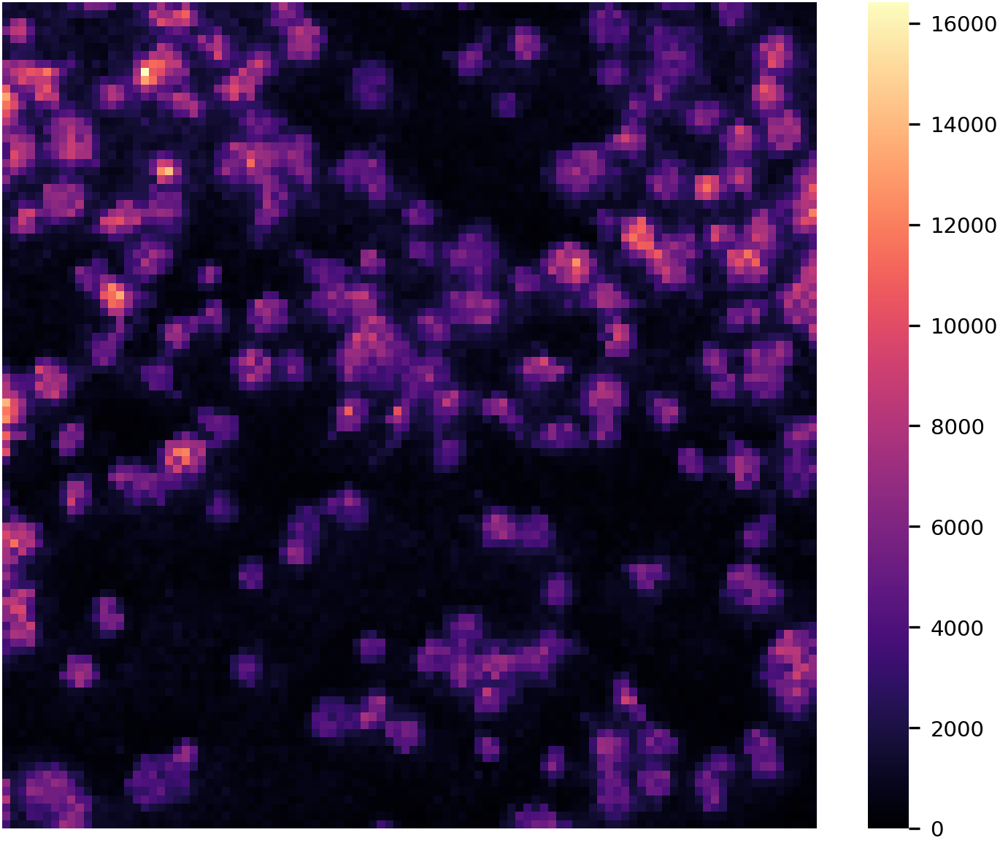

C16H30O2-H


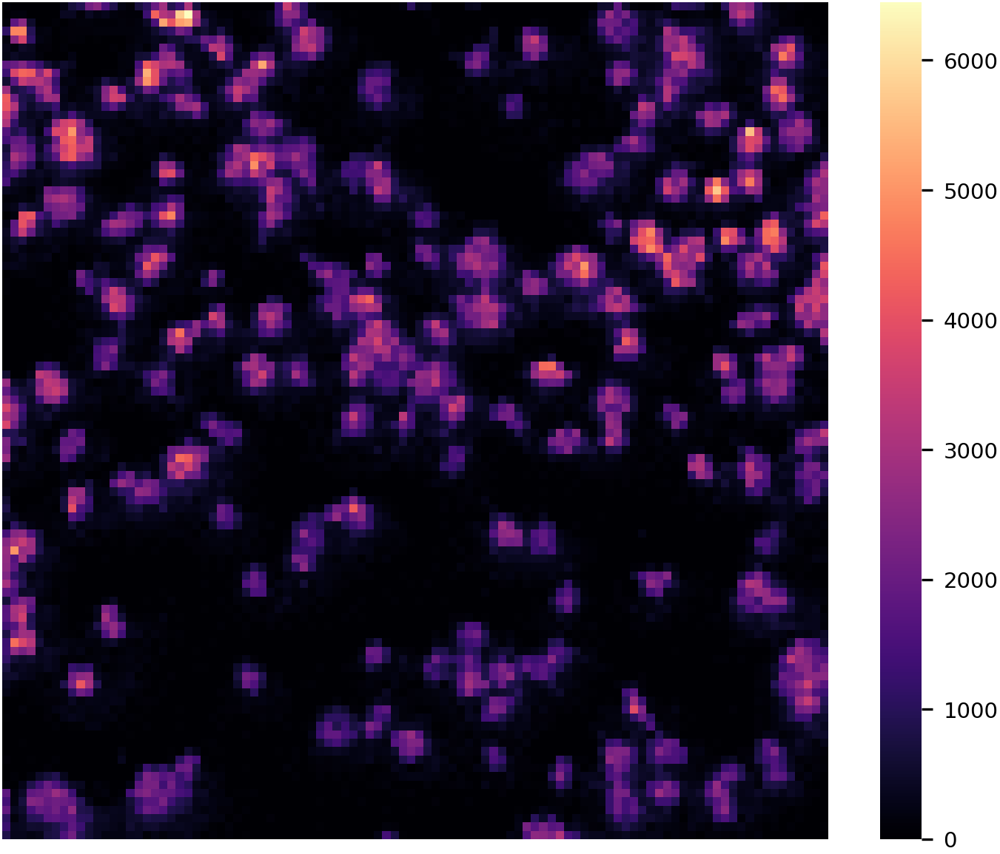

C14H28O2-H


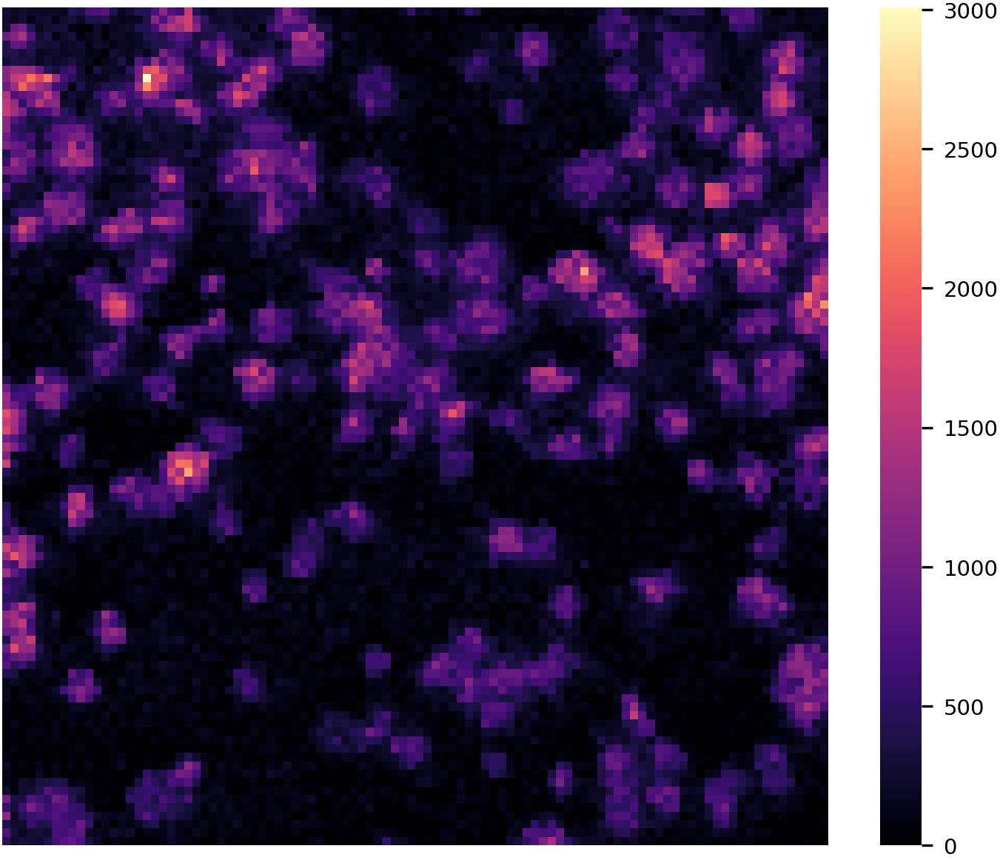

C12H24O2-H


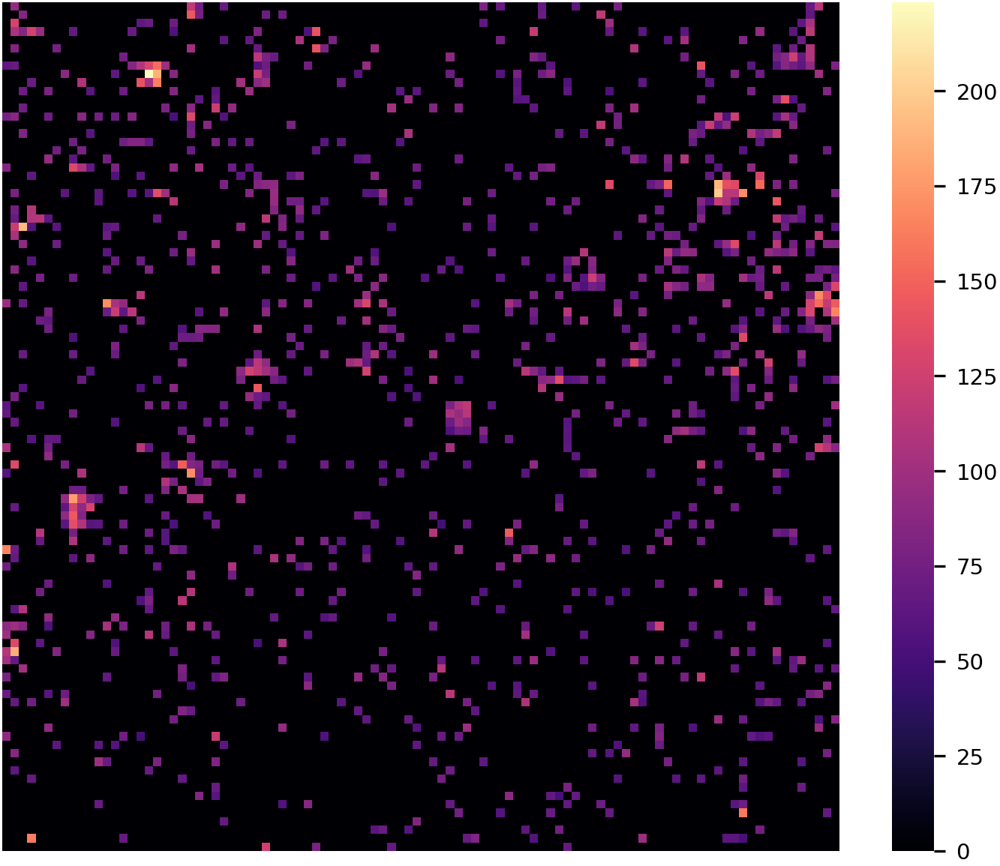

In [18]:
adata_am_S1W1 = adata_am[(adata_am.obs.slide == 1) & (adata_am.obs.well == 1)]
image_shape = (100, 100)
(plots_path / "S1W1_raw_ion_images").mkdir()
for idx, ion in adata_am_S1W1.var[adata_am_S1W1.var["M+"] == 0].iterrows():
    print(idx) 
    ion_X = adata_am_S1W1[:, idx].X
    plt.figure(figsize=(6, 5))
    sns.heatmap(ion_X.reshape(image_shape), cmap="magma", cbar=True)
    plt.axis("off")
    plt.savefig(plots_path / "S1W1_raw_ion_images" / f"{ion.name}.svg")
    plt.savefig(plots_path / "S1W1_raw_ion_images" / f"{ion.name}.png")
    plt.show()

In [140]:
adata_am_S3W7.var[adata_am_S3W7.var["M+"] == 0]

,index,annotation_id,formula,adduct,ionFormula,ion,mz,msm,fdr,databases,moleculeNames,moleculeIds,name,structure,unlabeled_annotation_id,M+,dm,x_idx
C18H36O2-H,0,C18H36O2-H,C18H36O2,-H,C18H35O2,C18H36O2-H-,283.264215,0.931665,0.05,"[[""SwissLipids"", ""2018-02-02""]]","[""Stearate""]","[""SLM:000000826""]",stearate,“FA 18:0”,C18H36O2-H,0,0.0,0
C18H34O2-H,0,C18H34O2-H,C18H34O2,-H,C18H33O2,C18H34O2-H-,281.248565,0.924278,0.05,"[[""SwissLipids"", ""2018-02-02""]]","[""Oleate"", ""(9E)-octadecenoate"", ""18:1(11E)"", ...","[""SLM:000000418"", ""SLM:000389844"", ""SLM:000001...",oleate,“FA 18:1”,C18H34O2-H,0,0.0,19
C16H32O2-H,0,C16H32O2-H,C16H32O2,-H,C16H31O2,C16H32O2-H-,255.232915,0.892784,0.05,"[[""SwissLipids"", ""2018-02-02""]]","[""Palmitate""]","[""SLM:000000510""]",palmitate,“FA 16:0”,C16H32O2-H,0,0.0,38
C16H30O2-H,0,C16H30O2-H,C16H30O2,-H,C16H29O2,C16H30O2-H-,253.217265,0.861395,0.05,"[[""SwissLipids"", ""2018-02-02""]]","[""16:1(6Z)"", ""16:1(9Z)""]","[""SLM:000000550"", ""SLM:000000411""]",FA 16:1,“FA 16:1”,C16H30O2-H,0,0.0,55
C14H28O2-H,0,C14H28O2-H,C14H28O2,-H,C14H27O2,C14H28O2-H-,227.201614,0.874477,0.05,"[[""SwissLipids"", ""2018-02-02""]]","[""Myristate""]","[""SLM:000000825""]",myristate,“FA 14:0”,C14H28O2-H,0,0.0,72
C12H24O2-H,0,C12H24O2-H,C12H24O2,-H,C12H23O2,C12H24O2-H-,199.170314,0.032842,0.05,"[[""SwissLipids"", ""2018-02-02""]]","[""Laurate""]","[""SLM:000000719""]",laurate,“FA 12:0”,C12H24O2-H,0,0.0,87


In [150]:
cropped_premaldi

{'Trans': array([[52426, 52685, 51803, ..., 51342, 50903, 51154],
        [51548, 50381, 51412, ..., 51641, 51553, 52087],
        [51085, 51015, 51608, ..., 50644, 50145, 48991],
        ...,
        [52210, 52455, 52847, ..., 52708, 52913, 52957],
        [52984, 51756, 52222, ..., 52805, 52603, 51928],
        [52431, 52304, 52969, ..., 51998, 51909, 52647]], dtype=uint16),
 'Dapi': array([[541, 505, 618, ..., 630, 614, 729],
        [577, 502, 516, ..., 638, 689, 749],
        [479, 482, 506, ..., 665, 722, 697],
        ...,
        [509, 587, 461, ..., 483, 498, 526],
        [495, 543, 550, ..., 505, 510, 514],
        [476, 448, 574, ..., 455, 534, 446]], dtype=uint16),
 'GFP': array([[183, 207, 220, ..., 215, 176, 202],
        [206, 196, 191, ..., 205, 159, 202],
        [159, 152, 175, ..., 214, 177, 186],
        ...,
        [183, 182, 162, ..., 173, 186, 171],
        [168, 158, 171, ..., 186, 172, 168],
        [209, 153, 174, ..., 167, 175, 182]], dtype=uint16)}

/media/buglakova/embl_data/data/lipid_isotope/20220411_AB_DKFZACLYac/slide1/spacem_data/W1
S1W1
Slide 1 well 1
count nonzero 9900
count nonzero 5153


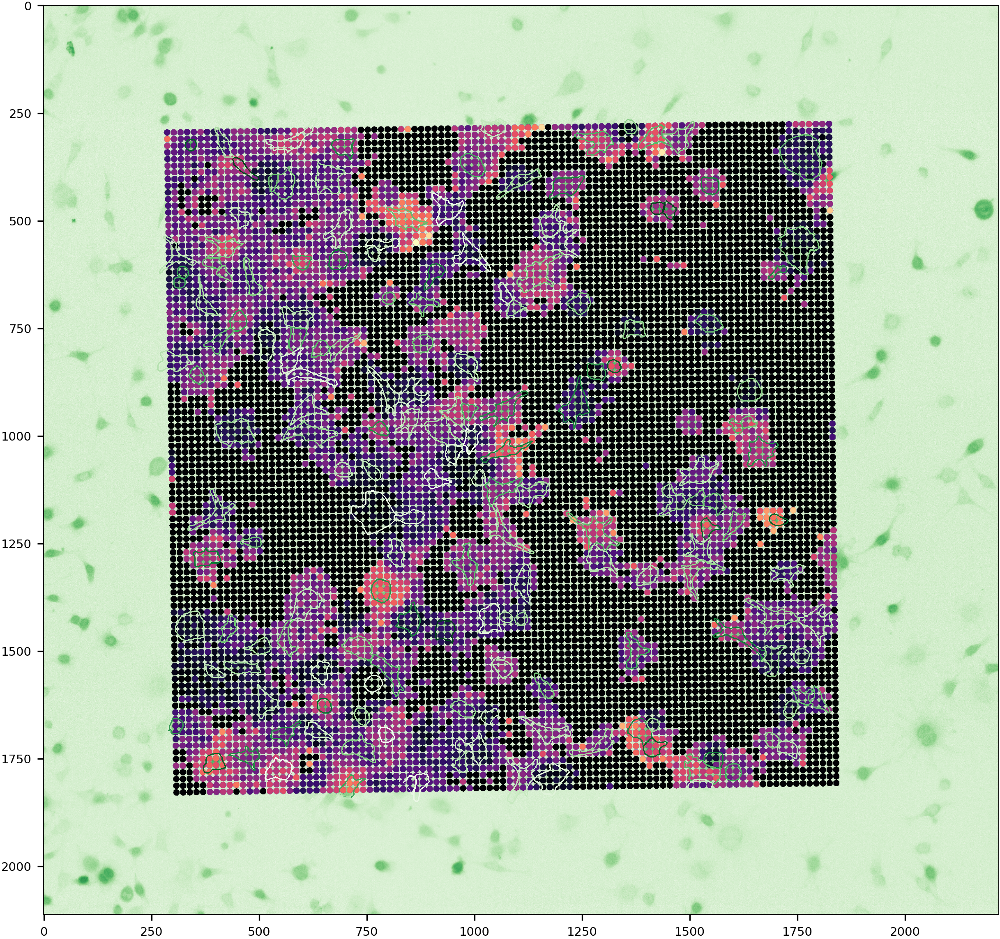

/media/buglakova/embl_data/data/lipid_isotope/20220411_AB_DKFZACLYac/slide1/spacem_data/W2
S1W2
Slide 1 well 2
count nonzero 9900
count nonzero 5684


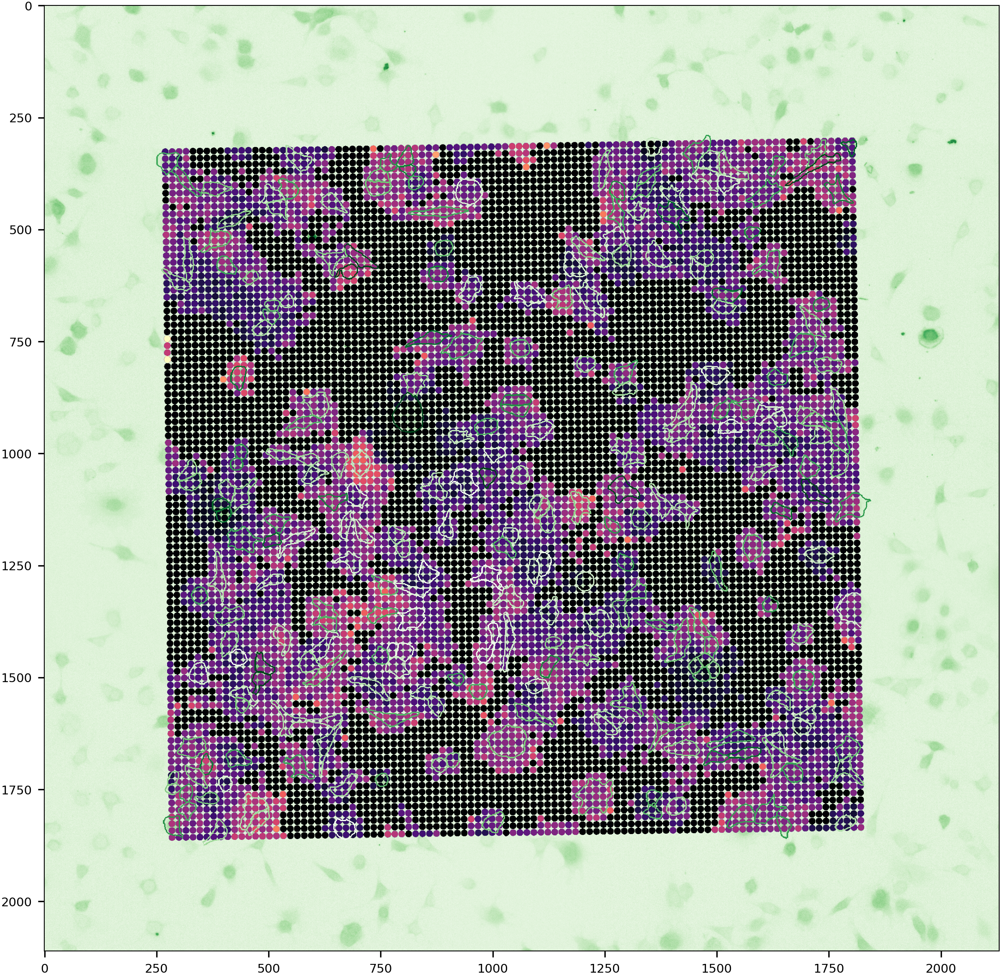

/media/buglakova/embl_data/data/lipid_isotope/20220411_AB_DKFZACLYac/slide1/spacem_data/W3
S1W3
Slide 1 well 3
count nonzero 9900
count nonzero 6575


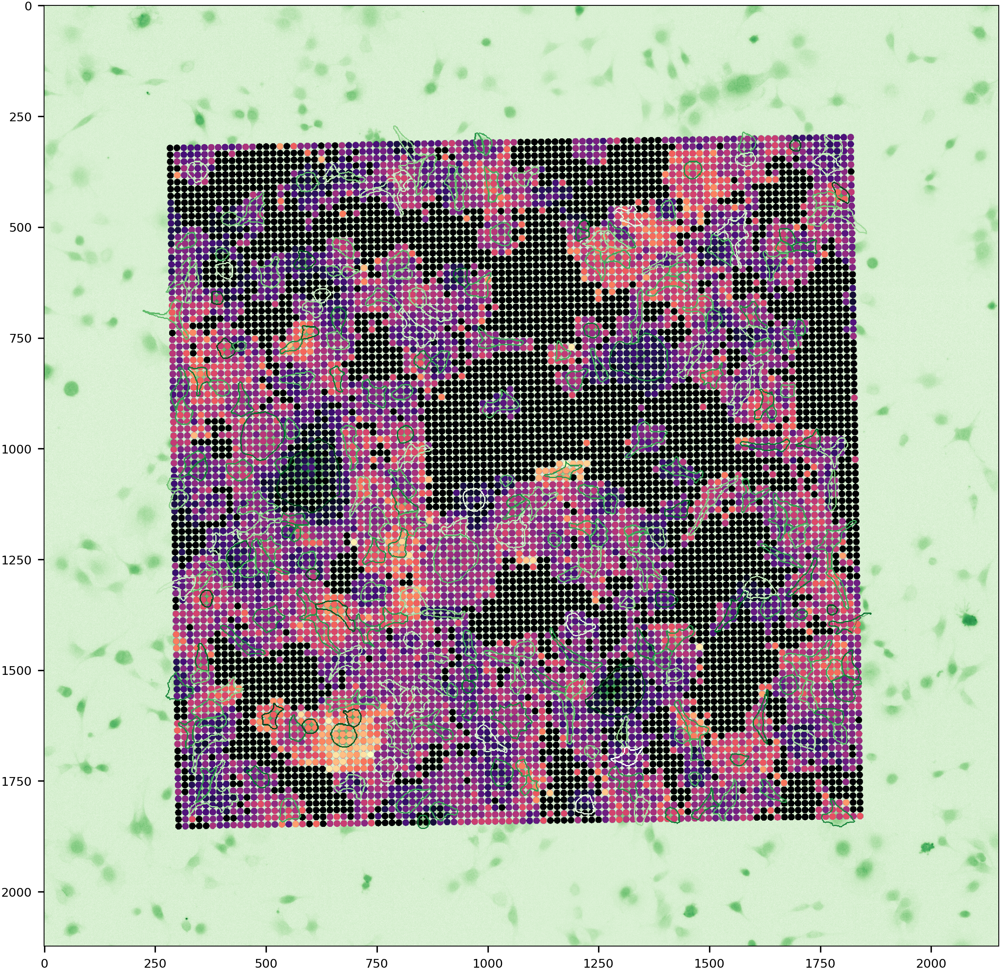

In [61]:
ion_name = "C16H32O2-H"
overlay_plots_path = plots_path / f"GFP_{ion_name}_M0_norm_ion_images_gfp"
overlay_plots_path.mkdir(exist_ok=True)

for spacem_dir in spacem_dir_list[:3]:
    print(spacem_dir)
    ds_name, cell_masks, cropped_premaldi, cropped_postmaldi, am_masks, overlap_masks = add_spacem_images(spacem_dir)
    print(ds_name)
    match = re.match(r"S(\d)W(\d)", ds_name)
    slide = int(match.group(1))
    well = int(match.group(2))
    print(f"Slide {slide} well {well}")
    
    adata_am_SW = adata_am[(adata_am.obs.slide == slide) & (adata_am.obs.well == well)]
    mapped_ams_ion = map_ion_feature_to_masks(am_masks, adata_am_SW, ion_name)
    
    cell_contours = segm_masks_to_contours(cell_masks)
    adata_SW = adata[(adata.obs.slide == slide) & (adata.obs.well == well)]
    
    
    mapped_cells_gfp = map_obs_feature_to_masks(cell_contours, adata_SW, "log_gfp")
    
    
    plt.figure(figsize=(10, 10))
    # plt.imshow(np.log(cropped_premaldi["GFP"]), alpha=(np.log(cropped_premaldi["GFP"]) - np.log(cropped_premaldi["GFP"]).min()) / np.log(cropped_premaldi["GFP"]).max(), cmap="Greens")
    plt.imshow(np.log(cropped_premaldi["GFP"]), cmap="Greens")
    plt.imshow(mapped_ams_ion, alpha = (am_masks>0).astype(float))
    # plt.imshow(cell_masks, alpha = (cell_masks>0).astype(float), cmap="hsv")
    
    plt.imshow(mapped_cells_gfp, alpha=(mapped_cells_gfp > 0).astype(float), interpolation="nearest", cmap="Greens")
    plt.savefig(overlay_plots_path / f"{ds_name}.svg")
    plt.savefig(overlay_plots_path / f"{ds_name}.png")
    plt.show()

In [157]:
adata_am.obs.center_x

cell_id
1-S1W1-0         286.419540
2-S1W1-0         286.694915
3-S1W1-0         286.949721
4-S1W1-0         287.050279
5-S1W1-0         287.335227
                   ...     
9996-S3W8-2     1727.825843
9997-S3W8-2     1727.910112
9998-S3W8-2     1728.050279
9999-S3W8-2     1728.264045
10000-S3W8-2    1728.348571
Name: center_x, Length: 240000, dtype: float64

(array([ 71., 204., 278., 301., 331., 438., 460., 494., 481., 438., 388.,
        311., 276., 241., 200., 169., 165., 117., 119.,  90.,  65.,  75.,
         69.,  52.,  48.,  37.,  52.,  27.,  29.,  24.,  23.,  14.,  14.,
         15.,  22.,  13.,  17.,   7.,  12.,   5.,   7.,   8.,   2.,   3.,
          5.,   1.,   2.,   1.,   2.,   3.,   2.,   0.,   1.,   2.,   3.,
          2.,   3.,   2.,   2.,   1.,   0.,   1.,   2.,   2.,   2.,   0.,
          1.,   0.,   0.,   1.,   0.,   0.,   1.,   0.,   0.,   0.,   0.,
          0.,   1.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,
          0.,   0.,   1.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,
          1.]),
 array([    0.     ,   377.54306,   755.0861 ,  1132.6292 ,  1510.1722 ,
         1887.7152 ,  2265.2583 ,  2642.8013 ,  3020.3445 ,  3397.8875 ,
         3775.4304 ,  4152.9736 ,  4530.5166 ,  4908.0596 ,  5285.6025 ,
         5663.1455 ,  6040.689  ,  6418.232  ,  6795.775  ,  7173.318  ,
         7550.861  ,  7928

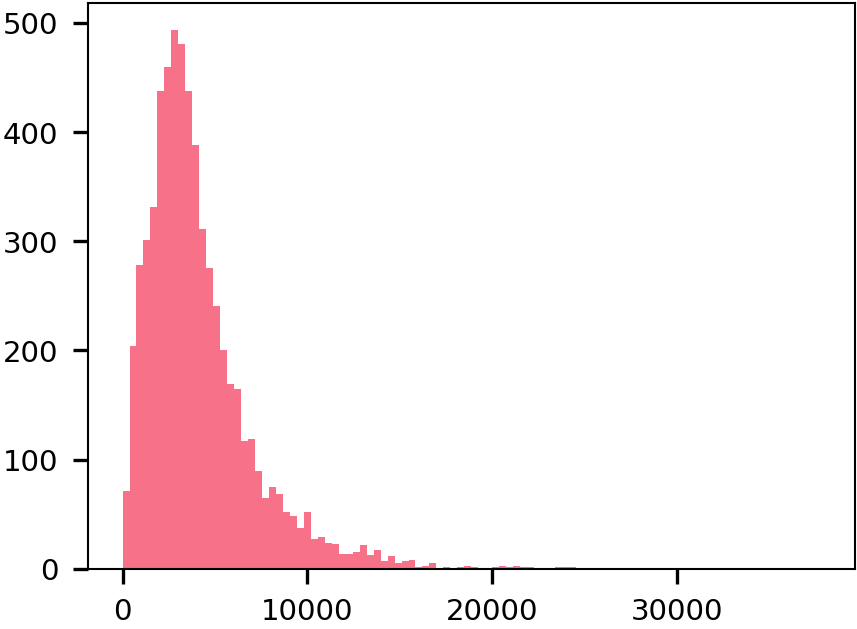

In [54]:
plt.hist(np.array(adata[:, ion_name].X.T[0]), bins=100)

In [55]:
adata[:, ion_name].X.T[0] < 1000

ArrayView([False, False, False, ..., False, False, False])

In [24]:
transform_matrix = [[0.2078957548590354, 15.501177312767856, 279.1772167077881], [15.484033762801173, -0.20766583224158672, 287.0236335060785], [0.0, 0.0, 1.0]]

scaling_matrix = [[10 / 0.64, 0, 0], [0, 10 / 0.64, 0],  [0.0, 0.0, 1.0]]

In [11]:
transform_matrix

[[0.2078957548590354, 15.501177312767856, 279.1772167077881],
 [15.484033762801173, -0.20766583224158672, 287.0236335060785],
 [0.0, 0.0, 1.0]]

In [12]:
from scipy.ndimage import affine_transform

In [41]:
aligned = affine_transform(mapped_cells_gfp, scaling_matrix @ np.linalg.inv(transform_matrix))
aligned_ams = affine_transform(mapped_ams_ion, scaling_matrix @ np.linalg.inv(transform_matrix))

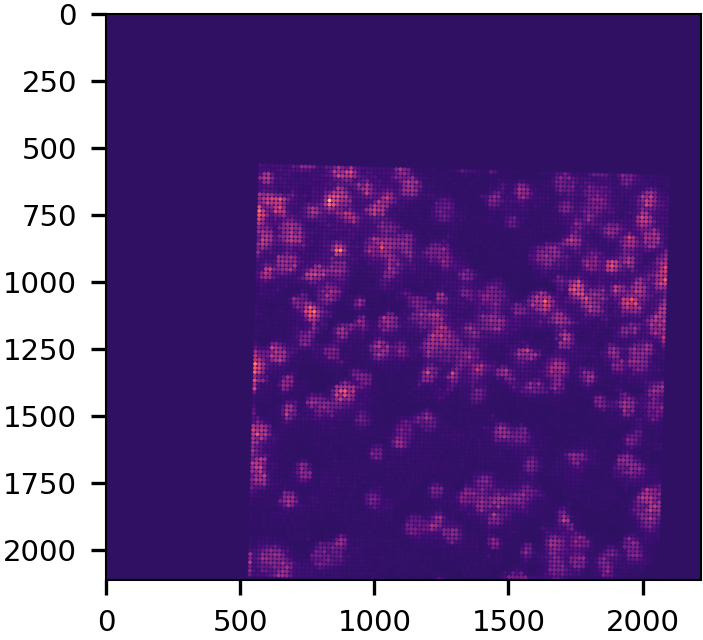

In [42]:
plt.imshow(aligned_ams)

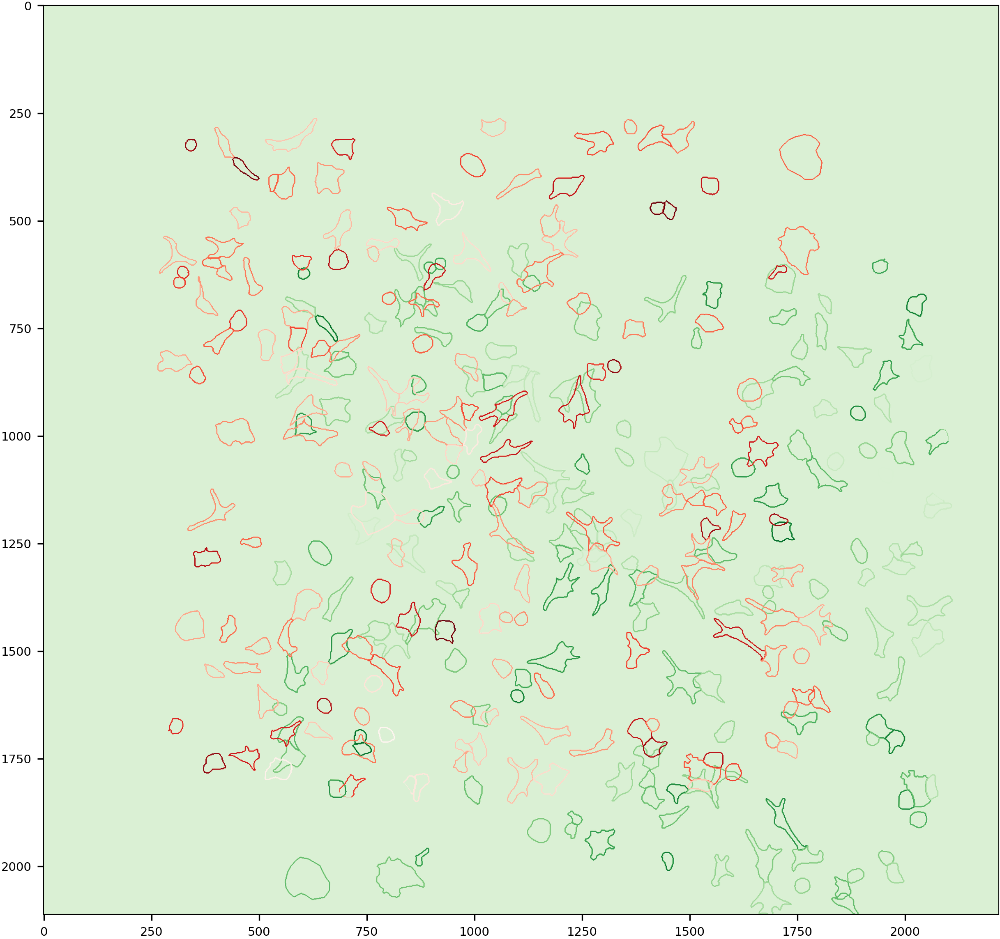

In [43]:
plt.figure(figsize=(10, 10))
plt.imshow(aligned_ams, cmap="magma", alpha=(aligned_ams > 0).astype(float))
plt.imshow(aligned, cmap="Greens")
plt.imshow(mapped_cells_gfp, cmap="Reds", alpha=(mapped_cells_gfp > 0).astype(float))